In [1]:
import numpy as np
import matplotlib.pyplot as plt
from functions_to_optimize import f_rastrigin
from CMA_obj import CMA_opt
from PEPG_obj import PEPG_opt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from SPSA_obj import SPSA_opt
from ADAM_opt import AdamOptimizer
from PSO_obj import PSO_opt
from Finite_diff_grad import FD_opt

# Rastrigin optimization 
In this Notebook we optimize the Rastrigin function with different learning strategies: 

- SPSA 
- CMA
- PEPG
- PSO


In [2]:
#test rastrigin function 
lower_bound = -1
upper_bound = 1
x_1 = np.linspace(lower_bound,upper_bound,200)[:,np.newaxis]
x_2 = np.linspace(lower_bound,upper_bound,200)[:,np.newaxis]

X_1, X_2 = np.meshgrid(x_1,x_2)

X = np.concatenate([X_1.ravel()[:,np.newaxis] , X_2.ravel()[:,np.newaxis]],axis=1)
F = np.zeros([X.shape[0],1])

for i in range(X.shape[0]):
    F[i] = f_rastrigin(X[i,:])
F_2 = np.reshape(F,[len(x_1),len(x_2)])

F_2 = np.reshape(np.apply_along_axis(f_rastrigin, 1, X),newshape=[len(x_1),len(x_2)])
# plot using plotly
fig = make_subplots(rows=1, cols=1, subplot_titles=["Rastrigin function"])

fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=1.5, showscale=True), row=1, col=1)
fig.update_layout(height = 400,width = 500,  margin=dict(l=20, r=20, t=20, b=20))
fig.show()


Initial reward:  25000.0
Best reward at iteration 0: 39013.842127386706
Best reward at iteration 100: 17647.85457316155
Best reward at iteration 200: 12787.679774979295
Best reward at iteration 300: 11770.788758687477
Best reward at iteration 400: 11238.074321953016
Best reward at iteration 500: 11201.47063669012
Best reward at iteration 600: 11187.82415944203
Best reward at iteration 700: 11480.148504641535
Best reward at iteration 800: 11029.829945105586
Best reward at iteration 900: 10686.07594821285
Best reward at iteration 1000: 9931.91066249212
Best reward at iteration 1100: 7579.512761857716
Best reward at iteration 1200: 3646.51299431797
Best reward at iteration 1300: 2103.2176041493194
Best reward at iteration 1400: 1705.8705549420174
Best reward at iteration 1500: 1627.9611646734556
Best reward at iteration 1600: 1612.5114379251463
Best reward at iteration 1700: 1609.5649804037403
Best reward at iteration 1800: 1608.983136033743
Best reward at iteration 1900: 1608.87358970127

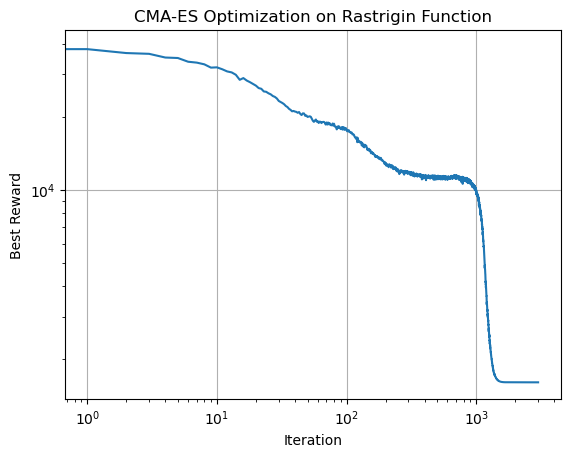

In [3]:
#use CMA-ES to optimize rastrigin function
epochs = 3000
N_dim = 1000
pop_size = 100

#init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

CMA_optimizer = CMA_opt(N_dim, pop_size, select_pop=int(pop_size/2), sigma_init=0.5, mean_init=init_pos)
#CMA_optimizer.eigen_update_frequency = 1
#print('Initial position: ', init_pos)
#print rastrigin function value at initial position
print('Initial reward: ', f_rastrigin(init_pos))

best_reward_cma = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
rewards_cma = np.zeros([epochs, pop_size])
coordinates_cma = np.zeros([epochs, N_dim, pop_size])

for i in range(int(epochs)):
    #ask for new coordinates
    coordinates = CMA_optimizer.ask()
    coordinates = coordinates.T
    #compute rewards / value of function to optimize
    rewards = np.reshape(np.apply_along_axis(f_rastrigin, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    # give rewards to optimizer for adaptation and mutation 
    CMA_optimizer.tell(reward_table=rewards)
    
    best_reward_cma[i] = np.min(rewards)
    #save history of rewards and coordinates
    rewards_cma[i, :] = rewards.T
    coordinates_cma[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_cma)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('CMA-ES Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Best reward at iteration 0: 39042.22267264444
Best reward at iteration 100: 14994.923402131473
Best reward at iteration 200: 12717.444307605256
Best reward at iteration 300: 11598.30334599505
Best reward at iteration 400: 11016.54978215911
Best reward at iteration 500: 10751.505071198784
Best reward at iteration 600: 10498.32192769625
Best reward at iteration 700: 10414.777925811126
Best reward at iteration 800: 10137.698939216918
Best reward at iteration 900: 10069.031508132537
Best reward at iteration 1000: 9999.245075624225
Best reward at iteration 1100: 9738.456505873482
Best reward at iteration 1200: 9758.771657414127
Best reward at iteration 1300: 9323.862139361518
Best reward at iteration 1400: 8676.629228000917
Best reward at iteration 1500: 7789.413714320874
Best reward at iteration 1600: 6588.031427127094
Best reward at iteration 1700: 5247.497035687731
Best reward at iteration 1800: 3880.3326696548984
Best reward at iteration 1900: 2707.785622730852
Best reward at iteration 

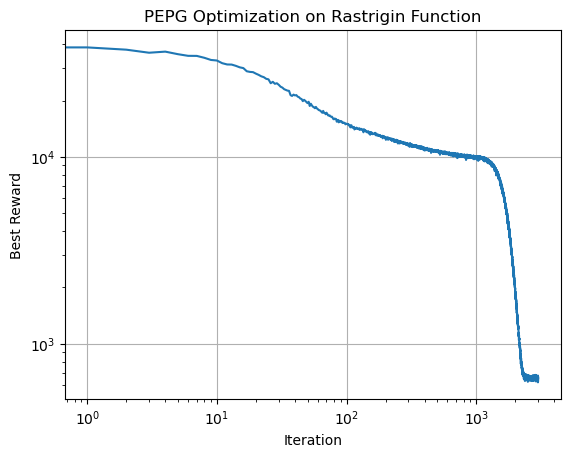

In [4]:
# use PEPG to optimize rastrigin function
epochs = 3000
N_dim = 1000
pop_size = 100

#create empty arrays to store rewards and coordinates at each iteration
rewards_pepg = np.zeros([epochs, pop_size])
coordinates_pepg = np.zeros([epochs, N_dim, pop_size])


#init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

best_reward_pepg = np.zeros(epochs)

PEPG_optimizer = PEPG_opt(N_dim, pop_size, learning_rate=0.05, starting_mu=init_pos ,starting_sigma=0.5)

for i in range(epochs):
    
    coordinates = PEPG_optimizer.ask()
    coordinates = coordinates.T
    rewards = np.reshape(np.apply_along_axis(f_rastrigin, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    rewards = rewards
    PEPG_optimizer.tell(rewards)
    
    best_reward_pepg[i] = np.min(rewards)
    #save history of rewards and coordinates
    rewards_pepg[i, :] = rewards.T
    coordinates_pepg[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_pepg)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('PEPG Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  25000.0
Best reward at iteration 0: 25043.70535396626
Best reward at iteration 100: 27629.33280832661
Best reward at iteration 200: 28606.801825551913
Best reward at iteration 300: 29341.582541932854
Best reward at iteration 400: 29702.727664016977
Best reward at iteration 500: 29963.38603010932
Best reward at iteration 600: 29978.068665668572
Best reward at iteration 700: 29991.128088317844
Best reward at iteration 800: 30062.048536019483
Best reward at iteration 900: 30006.409685829713
Best reward at iteration 1000: 30142.74607901255
Best reward at iteration 1100: 30133.655734727552
Best reward at iteration 1200: 30116.256693721523
Best reward at iteration 1300: 29955.643443794157
Best reward at iteration 1400: 29688.708661544253
Best reward at iteration 1500: 29592.69363374309
Best reward at iteration 1600: 29665.32072645639
Best reward at iteration 1700: 29525.72439945358
Best reward at iteration 1800: 29585.38223417855
Best reward at iteration 1900: 29622.63339836

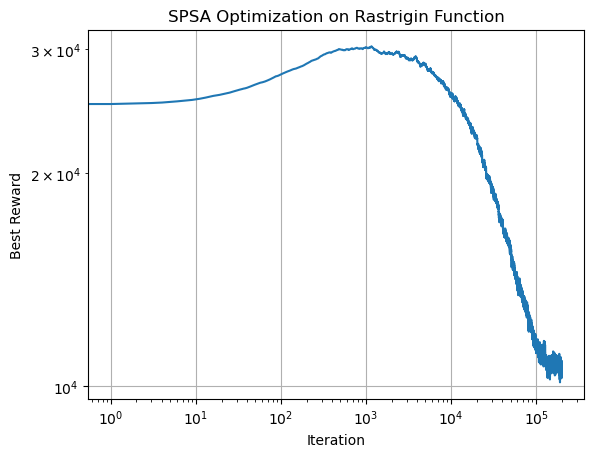

In [46]:
#use SPSA to optimize rastrigin function
epochs = 200000
N_dim = 1000
pop_size = 100

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

SPSA_optimizer = SPSA_opt(init_pos,alpha=1e-3,epsilon=1e-4)
Adam = AdamOptimizer(init_pos, lr=3e-3, beta1=0.9, beta2=0.9, epsilon=1e-8)
#print('Initial position: ', init_pos)
#print rastrigin function value at initial position
print('Initial reward: ', f_rastrigin(init_pos))

best_reward_spsa = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
rewards_spsa = np.zeros([epochs, pop_size])
coordinates_spsa = np.zeros([epochs, N_dim])

for i in range(int(epochs)):
    #perturb parameters
    params_plus, params_minus = SPSA_optimizer.perturb_parameters() 
    #compute rewards / value of function to optimize
    reward_plus = np.apply_along_axis(f_rastrigin, 0, params_plus)
    reward_minus = np.apply_along_axis(f_rastrigin, 0, params_minus)

    # give rewards to optimizer for adaptation and mutation 
    grad = SPSA_optimizer.approximate_gradient(reward_plus ,reward_minus)
    step = Adam.step(grad)
    
    #coordinates_spsa[i, :] = SPSA_optimizer.update_parameters(grad).squeeze()
    coordinates_spsa[i, :] = SPSA_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_spsa[i] = np.apply_along_axis(f_rastrigin, 0, SPSA_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_spsa[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_spsa)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('SPSA Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  25000.0
Best reward at iteration 0: 40250.0000000009
Best reward at iteration 500: 4033.081180312248
Best reward at iteration 1000: 3986.8992256391257
Best reward at iteration 1500: 3986.668415954762


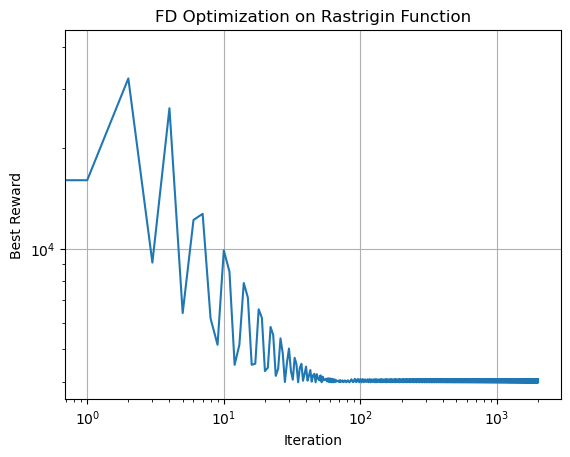

In [34]:
#Using finite difference to optimize rastrigin function
epochs = 2000
N_dim = 1000
grad_dim = 1000

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

FD_optimizer = FD_opt(init_pos,n_perturb=grad_dim,alpha=1e-3,epsilon=1e-5)
Adam = AdamOptimizer(init_pos, lr=1e-1, beta1=0.9, beta2=0.9, epsilon=1e-8)

#print rastrigin function value at initial position
print('Initial reward: ', f_rastrigin(init_pos))

best_reward_fd = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
coordinates_fd = np.zeros([epochs, N_dim])

FD_optimizer.n_perturb = grad_dim


for i in range(int(epochs)):
    grad = np.zeros([N_dim,1])
    FD_optimizer.generate_perturb_idx()
    for k in range(len(FD_optimizer.perturb_idx)):
        #perturb parameters
        params_plus, params_minus = FD_optimizer.perturb_parameters() 
        #compute rewards / value of function to optimize
        reward_plus = np.apply_along_axis(f_rastrigin, 0, params_plus)
        reward_minus = np.apply_along_axis(f_rastrigin, 0, params_minus)

        # give rewards to optimizer for adaptation and mutation 
        grad[FD_optimizer.perturb_idx[k]] = FD_optimizer.approximate_gradient(reward_plus ,reward_minus)
        
    
    step = Adam.step(grad)
    
    coordinates_fd[i, :] = FD_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_fd[i] = np.apply_along_axis(f_rastrigin, 0, FD_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%500==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_fd[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_fd)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('FD Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


Initial reward:  25000.0
Best reward at iteration 0: 24999.87374159405
Best reward at iteration 500: 28234.84436736028
Best reward at iteration 1000: 30574.742878392684
Best reward at iteration 1500: 31942.15606627723
Best reward at iteration 2000: 32480.930660998252
Best reward at iteration 2500: 32734.337939071374
Best reward at iteration 3000: 31727.22242868278
Best reward at iteration 3500: 30683.295798611718
Best reward at iteration 4000: 29258.082420027928
Best reward at iteration 4500: 28058.503364142685
Best reward at iteration 5000: 26853.97262358061
Best reward at iteration 5500: 25552.29211666871
Best reward at iteration 6000: 25174.806227800862
Best reward at iteration 6500: 24671.150966237525
Best reward at iteration 7000: 23888.951035456397
Best reward at iteration 7500: 22817.250670110232
Best reward at iteration 8000: 21897.092880744116
Best reward at iteration 8500: 21263.744421423897
Best reward at iteration 9000: 20201.666900809018
Best reward at iteration 9500: 1956

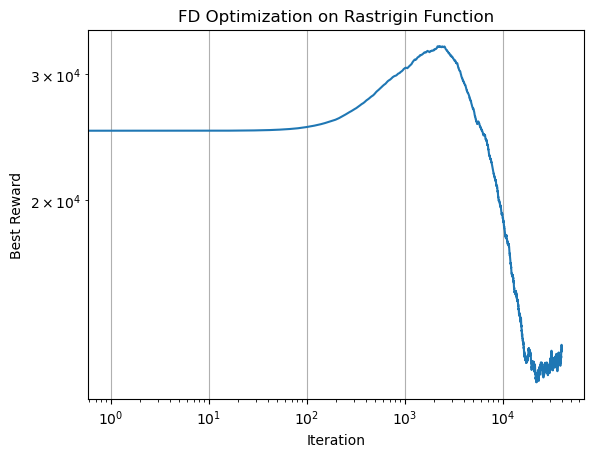

In [31]:
#Using finite difference to optimize rastrigin function
epochs = 40000
N_dim = 1000
grad_dim = 1

init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, 1) + lower_bound
init_pos = 1 * np.ones([N_dim, 1])

FD_optimizer = FD_opt(init_pos,n_perturb=grad_dim,alpha=1e-3,epsilon=1e-5)
Adam = AdamOptimizer(init_pos, lr=5e-3, beta1=0.9, beta2=0.99, epsilon=1e-8)

#print rastrigin function value at initial position
print('Initial reward: ', f_rastrigin(init_pos))

best_reward_fd_1 = np.zeros(epochs)

#create empty arrays to store rewards and coordinates at each iteration
coordinates_fd_1 = np.zeros([epochs, N_dim])

FD_optimizer.n_perturb = grad_dim


for i in range(int(epochs)):
    grad = np.zeros([N_dim,1])
    FD_optimizer.generate_perturb_idx()
    for k in range(len(FD_optimizer.perturb_idx)):
        #perturb parameters
        params_plus, params_minus = FD_optimizer.perturb_parameters() 
        #compute rewards / value of function to optimize
        reward_plus = np.apply_along_axis(f_rastrigin, 0, params_plus)
        reward_minus = np.apply_along_axis(f_rastrigin, 0, params_minus)

        # give rewards to optimizer for adaptation and mutation 
        grad[FD_optimizer.perturb_idx[k]] = FD_optimizer.approximate_gradient(reward_plus ,reward_minus)
        
    
    step = Adam.step(grad)
    
    coordinates_fd_1[i, :] = FD_optimizer.update_parameters_step(step).squeeze()
    
    best_reward_fd_1[i] = np.apply_along_axis(f_rastrigin, 0, FD_optimizer.params)[0]
    #save history of rewards and coordinates
    
    if i%500==0:
        print('Best reward at iteration {}: {}'.format(i, best_reward_fd_1[i]))
        
# Plotting after all iterations
plt.loglog(best_reward_fd_1)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('FD Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


C:\Users\Admin\AppData\Local\Temp\ipykernel_17804\3184609332.py:40: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



Best reward at iteration 0: 12752.639019596852
Best reward at iteration 100: 10787.24122642272
Best reward at iteration 200: 10457.83283847536
Best reward at iteration 300: 10136.112032590705
Best reward at iteration 400: 9662.807424247869
Best reward at iteration 500: 9360.2176085922
Best reward at iteration 600: 9218.680837534948
Best reward at iteration 700: 8883.078172543426
Best reward at iteration 800: 8482.301620119144
Best reward at iteration 900: 8082.311281010011
Best reward at iteration 1000: 7841.6508004522675
Best reward at iteration 1100: 7744.040202361171
Best reward at iteration 1200: 7591.126726109484
Best reward at iteration 1300: 7516.0177004318075
Best reward at iteration 1400: 7343.1284054428
Best reward at iteration 1500: 7294.064701332751
Best reward at iteration 1600: 7110.987211165273
Best reward at iteration 1700: 6971.590187226062
Best reward at iteration 1800: 6866.595975158241
Best reward at iteration 1900: 6732.301881053794
Best reward at iteration 2000: 6

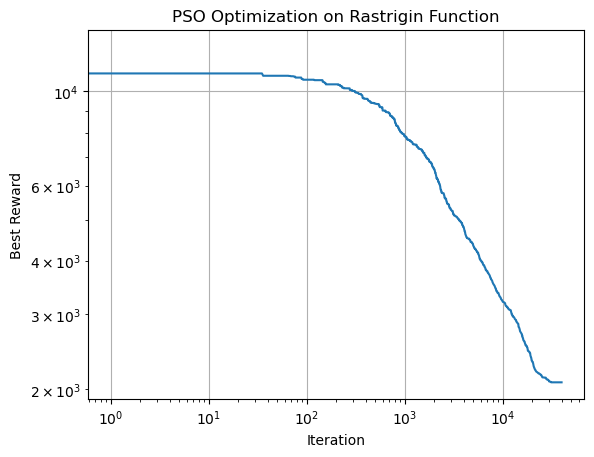

In [8]:
# use PSO to optimize rastrigin function
epochs = 40000
N_dim = 1000
pop_size = 100

#create empty arrays to store rewards and coordinates at each iteration
#rewards_pso = np.zeros([epochs, pop_size])
#coordinates_pso = np.zeros([epochs, N_dim, pop_size])


init_pos = (upper_bound - lower_bound) * np.random.rand(N_dim, pop_size) + lower_bound
#init_pos = 1 * np.ones([N_dim, pop_size])

#V_init = 0.1 * np.ones([N_dim, pop_size])
#random initial velocity
V_init = 0.1 * np.random.rand(N_dim, pop_size)

#params dictionary
params = {'c_1': 2.5, 
          'c_2': 0.85,
          'w': 0.7,
          'Vmax': 0.15*(upper_bound-lower_bound),
          'upper_bound': upper_bound,
          'lower_bound': lower_bound,
          }

best_reward_pso = np.zeros(epochs)

PSO_optimizer = PSO_opt(X_init = init_pos,V_init = V_init,params=params)
#PSO_optimizer.reward_history = np.zeros([epochs, pop_size])

for i in range(epochs):
    
    coordinates = PSO_optimizer.ask()

    rewards = np.reshape(np.apply_along_axis(f_rastrigin, 1, coordinates.T), newshape=[np.shape(coordinates)[1], 1])
    #PSO_optimizer.reward_history[i, :] = rewards.T
    PSO_optimizer.tell(rewards)
    
    best_reward_pso[i] = PSO_optimizer.best_reward
    #save history of rewards and coordinates
    #rewards_pso[i, :] = rewards.T
    #coordinates_pso[i, :, :] = coordinates
    
    if i%100==0:
        print('Best reward at iteration {}: {}'.format(i, np.min(rewards)))
        
# Plotting after all iterations
plt.loglog(best_reward_pso)
plt.xlabel('Iteration')
plt.ylabel('Best Reward')
plt.title('PSO Optimization on Rastrigin Function')
plt.grid(True)
plt.show()


In [36]:

cma_time = 113.5
pepg_time = 10.6
pso_time = 166
spsa_time = 4.2
fd_1000_time = 190
fd_1_time = 8


fig = make_subplots(rows=1, cols = 3,shared_yaxes=True, 
                    subplot_titles=["Performance vs epochs", "Performance vs runtime", "Performance vs function evaluations"])


fig.add_trace(go.Scatter(x=np.arange(3000), y=best_reward_cma, mode='lines', name='CMA-ES',showlegend = False,
                         line=dict(color='orangered', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(3000), y=best_reward_pepg, mode='lines', name='PEPG',showlegend=False,
                         line=dict(color='forestgreen', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(40000), y=best_reward_pso, mode='lines', name='PSO',showlegend=False,
                         line=dict(color='slategrey', width=2)), row=1, col=1)
fig.add_trace(go.Scatter(x=np.arange(16000), y=best_reward_spsa, mode='lines', name='SPSA',showlegend= False,
                         line=dict(color='deepskyblue', width=2)), row=1, col=1)

fig.update_xaxes(title_text="Epochs",type = 'log',exponentformat="power", row=1, col=1)
fig.update_yaxes(title_text="f(x)", type = 'log',exponentformat="power",row=1, col=1)


fig.add_trace(go.Scatter(x=np.linspace(0,cma_time,len(best_reward_cma)), y=best_reward_cma, mode='lines', name='CMA-ES',
                         line=dict(color='orangered', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,pepg_time,len(best_reward_pepg)), y=best_reward_pepg, mode='lines', name='PEPG',
                         line=dict(color='forestgreen', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,pso_time,len(best_reward_pso)), y=best_reward_pso, mode='lines', name='PSO',
                         line=dict(color='slategrey', width=2)), row=1, col=2)
fig.add_trace(go.Scatter(x=np.linspace(0,spsa_time,len(best_reward_spsa)), y=best_reward_spsa, mode='lines', name='SPSA',
                         line=dict(color='deepskyblue', width=2)), row=1, col=2)

fig.update_xaxes(title_text="Time [s]",type = 'log',exponentformat="power", row=1, col=2)
fig.update_yaxes( type = 'log',row=1, col=2)


fig.add_trace(go.Scatter(x=np.arange(3000)*100, y=best_reward_cma, mode='lines', name='CMA-ES',showlegend = False,
                         line=dict(color='orangered', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(3000)*100, y=best_reward_pepg, mode='lines', name='PEPG',showlegend=False,
                         line=dict(color='forestgreen', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(40000)*100, y=best_reward_pso, mode='lines', name='PSO',showlegend=False,
                         line=dict(color='slategrey', width=2)), row=1, col=3)
fig.add_trace(go.Scatter(x=np.arange(16000)*2, y=best_reward_spsa, mode='lines', name='SPSA',showlegend= False,
                         line=dict(color='deepskyblue', width=2)), row=1, col=3)

fig.update_xaxes(title_text="# function evaluations",type = 'log',exponentformat="power", row=1, col=3)
fig.update_yaxes( type = 'log',row=1, col=3)

fig.update_layout(height = 300,width = 1000,template="plotly_white")

In [37]:
from numpy import asarray
from numpy import savetxt
savetxt('data\\Results\\Rastrigin\\best_reward_cma.csv', best_reward_cma, delimiter=',')
savetxt('data\\Results\\Rastrigin\\best_reward_pepg.csv', best_reward_pepg, delimiter=',')
savetxt('data\\Results\\Rastrigin\\best_reward_pso.csv', best_reward_pso, delimiter=',')
savetxt('data\\Results\\Rastrigin\\best_reward_spsa_optim.csv', best_reward_spsa, delimiter=',')
savetxt('data\\Results\\Rastrigin\\best_reward_fd_1000.csv', best_reward_fd, delimiter=',')
savetxt('data\\Results\\Rastrigin\\best_reward_fd_1.csv', best_reward_fd_1, delimiter=',')

conv_time = np.array([cma_time, pepg_time, pso_time, spsa_time, fd_1000_time, fd_1_time])
num_epochs = np.array([3000, 3000, 40000, 16000, 2000,40000])
savetxt('data\\Results\\Rastrigin\\time.csv', conv_time, delimiter=',')
savetxt('data\\Results\\Rastrigin\\epochs.csv', num_epochs, delimiter=',')


In [ ]:
savetxt('data\\Results\\Rastrigin\\best_reward_spsa_local.csv', best_reward_spsa, delimiter=',')

In [10]:
# this is using plotly it looks much better
epochs_to_plot = [0, 100, 500, 1000, 1500, 2000, 2500,2900]
# Create subplots
fig = make_subplots(rows=2, cols=4, subplot_titles=[f'Epoch {epoch}' for epoch in epochs_to_plot],
                    horizontal_spacing=0.02, vertical_spacing=0.1)

# Index for accessing epochs to plot
k = 0

for i in range(1, 3):
    for j in range(1, 5):
        # Add contour plot of the Rastrigin function
        fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=0, showscale=False, 
                                 name='', hoverinfo='skip'), row=i, col=j)
        
        # Add scatter plot for the distribution of coordinates
        fig.add_trace(go.Scatter(x=coordinates_cma[epochs_to_plot[k], 0, :], 
                                 y=coordinates_cma[epochs_to_plot[k], 1, :], mode='markers',
                                 marker=dict(color='white', size=5, opacity=0.8, line=dict(color='black', width=1)),
                                 name='Population',showlegend=(k==0)), row=i, col=j)
        
        # Add scatter plot for the mean of the distribution
        fig.add_trace(go.Scatter(x=[np.mean(coordinates_cma[epochs_to_plot[k], 0, :])], 
                                 y=[np.mean(coordinates_cma[epochs_to_plot[k], 1, :])], mode='markers',
                                 marker=dict(color='darkred', size=10, line=dict(color='white', width=1)),
                                 name='Mean',showlegend=(k==0)), row=i, col=j)
        
        # Set axis limits
        fig.update_xaxes(range=[lower_bound, upper_bound], row=i, col=j)
        fig.update_yaxes(range=[lower_bound, upper_bound], row=i, col=j)
        
        k += 1

# Update layout
fig.update_layout(title_text='CMA-ES Optimization on Rastrigin Function', height=500, width=900)

fig.show()

In [11]:
# this is using plotly it looks much better

epochs_to_plot = [0, 100, 500, 1000, 1500, 2000, 2500,2900]
# Create subplots
fig = make_subplots(rows=2, cols=4, subplot_titles=[f'Epoch {epoch}' for epoch in epochs_to_plot],
                    horizontal_spacing=0.02, vertical_spacing=0.1)

# Index for accessing epochs to plot
k = 0

for i in range(1, 3):
    for j in range(1, 5):
        # Add contour plot of the Rastrigin function
        fig.add_trace(go.Contour(z=F_2, x=X_1[0, :], y=X_2[:, 0], colorscale='Turbo', contours_coloring='fill',  # Fill the contours
                                line_width=0, showscale=False, 
                                 name='', hoverinfo='skip'), row=i, col=j)
        
        # Add scatter plot for the distribution of coordinates
        fig.add_trace(go.Scatter(x=coordinates_pepg[epochs_to_plot[k], 0, :], 
                                 y=coordinates_pepg[epochs_to_plot[k], 1, :], mode='markers',
                                 marker=dict(color='white', size=5, opacity=0.8, line=dict(color='black', width=1)),
                                 name='Population',showlegend=(k==0)), row=i, col=j)
        
        # Add scatter plot for the mean of the distribution
        fig.add_trace(go.Scatter(x=[np.mean(coordinates_pepg[epochs_to_plot[k], 0, :])], 
                                 y=[np.mean(coordinates_pepg[epochs_to_plot[k], 1, :])], mode='markers',
                                 marker=dict(color='darkred', size=10, line=dict(color='white', width=1)),
                                 name='Mean',showlegend=(k==0)), row=i, col=j)
        
        # Set axis limits
        fig.update_xaxes(range=[lower_bound, upper_bound], row=i, col=j)
        fig.update_yaxes(range=[lower_bound, upper_bound], row=i, col=j)
        
        k += 1

# Update layout
fig.update_layout(title_text='PEPG Optimization on Rastrigin Function', height=500, width=900)

fig.show()